### Tutorial code for exploring an h5 file

#### Import necessary libraries


In [ ]:
try:
    import cv2
    import os
    import numpy as np
    import h5py
    import matplotlib.pyplot as plt
    from IPython.display import Video
except ImportError as e:
    missing = str(e).split()[-1].strip("'")
    msg = f"""
        Missing dependency: {missing}

        Please install requirements, e.g.:

        conda create -n reaching_ds python=3.10 -y
        conda activate reaching_ds
        pip install numpy matplotlib h5py jupyterlab ipympl pysampled scikit-learn

        Then re-run this script.
        """
    raise SystemExit(msg) from e
%matplotlib widget

#### Define own dataset path and subject to open

In [2]:
DATASET_PATH = r"C:\data\dataset_paper"
SUBJECT = "s14004"

#### Open file and explore its contents

In [3]:
h5file = h5py.File(os.path.join(DATASET_PATH, 'hdf5_files', f'{SUBJECT}.h5'))

def print_structure(name, obj): print(name)
h5file.visititems(print_structure)

events
events/extension
events/midpoint
events/palm_down
events/palm_up
events/retraction
events/tremor_biceps
events/tremor_palm
events/tremor_triceps
events/trial_limits
metadata
timeseries
timeseries/acc
timeseries/acc/data
timeseries/acc/time
timeseries/arm_speed
timeseries/arm_speed/data
timeseries/arm_speed/time
timeseries/emg
timeseries/emg/data
timeseries/emg/time
timeseries/emg_amplitude
timeseries/emg_amplitude/data
timeseries/emg_amplitude/time
timeseries/mocap
timeseries/mocap/data
timeseries/mocap/time
timeseries/tremor_power
timeseries/tremor_power/data
timeseries/tremor_power/time
timeseries/us_trackers
timeseries/us_trackers/data
timeseries/us_trackers/time
timeseries/us_trackers/time_orig


#### First let's explore the metadata

In [4]:
# Access all attributes iteratively and print key: value
print("="*8 + "Metadata" + "="*8)
demographics = h5file["metadata"]
for k, v in demographics.attrs.items():
    print(f"{k}: {v}")
    
# To access individual keys instead of iterating over them you can do
print("\n" + "="*30)
print("Single key, e.g., height (cm)")
demographics.attrs['height_cm']

========Metadata========
age: 21
arm_length_cm: 60.65419638565655
dominant_side: Right
expertise_level: intermediate
gender: F
height_cm: 157
muscle_thickness_mm: 6.37672811059908
primary_activity: Volleyball
probe_side: Left
weight_kg: 49

Single key, e.g., height (cm)


np.int64(157)

#### Plot subject's motion capture (mocap) data

In [5]:
# First get marker names as well as other relevant information
mocap_data = h5file["timeseries/mocap"]
print(f"Marker names: {mocap_data.attrs['markers']}")
print(f"Sampling rate [Hz]: {mocap_data.attrs['sr']}")
print(f"Units: {mocap_data.attrs['units']}")
print(f"Description: {mocap_data.attrs['description']}")

Marker names: ['hand' 'forearm' 'elbow' 'upperarm' 'shoulder']
Sampling rate [Hz]: 240.0
Units: cm
Description: Optitrack motion capture data for arm markers. The array is a 3D array with shape (samples, markers, coordinates).


Text(0.5, 0.98, 'Arm Marker Position')

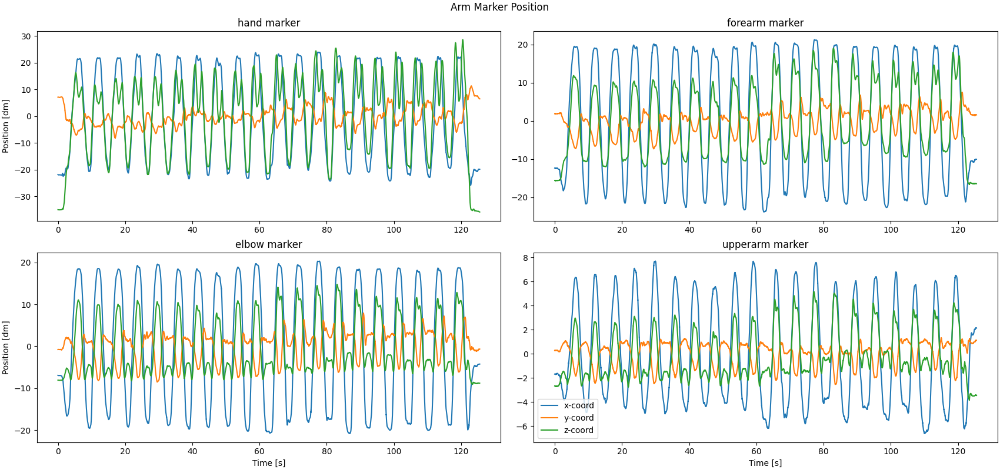

In [6]:
# Retrieve data from h5file and plot the first 4 arm markers
time = mocap_data['time'][()]
mocap_arrays = mocap_data['data'][()]
marker_names = mocap_data.attrs['markers']

fig, axes = plt.subplots(2, 2, figsize=(17, 8), constrained_layout=True)
for idx, marker in enumerate(marker_names[:-1]):
    ax = axes.flatten()[idx]
    # Centering data just for visualization purposes
    data_plot = mocap_arrays[:, idx] - mocap_arrays[:, idx].mean(axis=0)
    ax.plot(time, data_plot, lw=1.5)
    ax.set_title(f"{marker} marker")
    if idx % 2 == 0:
        ax.set_ylabel("Position [dm]")
    if idx - 1 >= 1:
        ax.set_xlabel("Time [s]")
        
ax.legend(["x-coord", "y-coord", "z-coord"])
fig.suptitle("Arm Marker Position")

#### Plot subject's arm speed with extension/retraction intervals

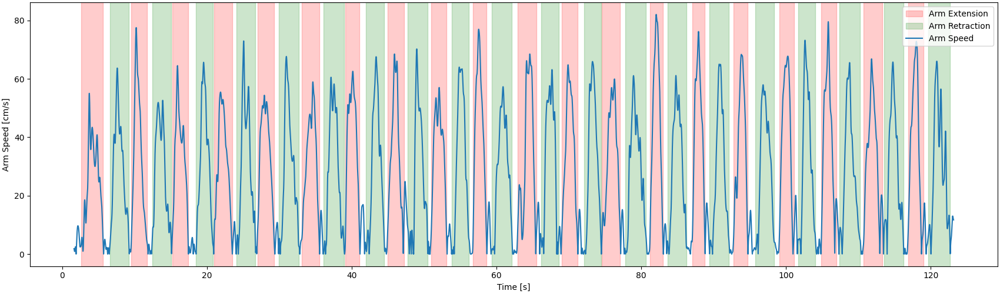

In [7]:
# Retrieve and plot arm speed with events
arm_time = h5file['timeseries/arm_speed/time'][()]
arm_data = h5file['timeseries/arm_speed/data'][()]
units = h5file['timeseries/arm_speed'].attrs['units']

extension = h5file['events/extension'][()]
retraction = h5file['events/retraction'][()]

fig, ax = plt.subplots(1, 1, figsize=(17, 5), constrained_layout=True)
min_v, max_v = np.min(arm_data), np.max(arm_data)

# Plot extension shaded areas
for start, end in extension:
    ax.axvspan(start, end, color='red', alpha=0.2, label='Arm Extension')

# Plot retraction shaded areas
for start, end in retraction:
    ax.axvspan(start, end, color='green', alpha=0.2, label='Arm Retraction')
    
ax.plot(arm_time, arm_data, lw=1.5, label='Arm Speed')
ax.set_xlabel("Time [s]")
ax.set_ylabel(f"Arm Speed [{units}]")

# Fix duplicated legend entries
handles, labels = ax.get_legend_handles_labels()
unique = dict(zip(labels, handles))
ax.legend(unique.values(), unique.keys(), loc='upper right')

#### Plot subject's acceleration and tremor power on the triceps with tremor events

['triceps' 'biceps' 'palm']


(86.0, 98.0)

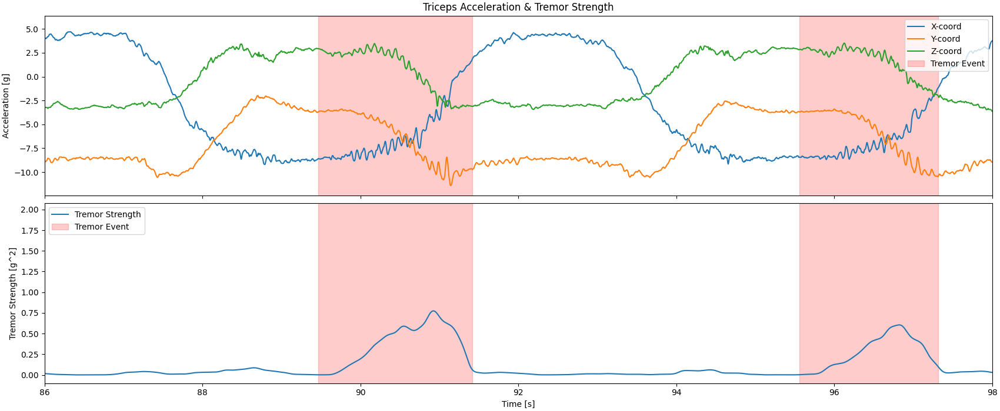

In [8]:
# Retrieve and plot acceleration, tremor strength, and tremor events
acc_time = h5file['timeseries/acc/time'][()]
acc_data = h5file['timeseries/acc/data'][()]

tp_time = h5file['timeseries/tremor_power/time'][()]
tp_data = h5file['timeseries/tremor_power/data'][()]

# Print locations to confirm that triceps is in position 0
locations = h5file['timeseries/acc'].attrs['locations']
print(locations)

fig, axes = plt.subplots(2, 1, figsize=(17, 7), constrained_layout=True, sharex=True)
events = h5file[f'events/tremor_triceps'][()]

axes[0].plot(acc_time, acc_data[:, 0])
axes[0].set_title(f"Triceps Acceleration & Tremor Strength")

axes[1].plot(tp_time, tp_data[:, 0])
axes[1].set_xlabel("Time [s]")

axes[0].set_ylabel('Acceleration [g]')
axes[1].set_ylabel('Tremor Strength [g^2]')

# Plot tremor events
for start, end in events:
    axes[0].axvspan(start, end, color='red', alpha=0.2, label='Tremor')
    axes[1].axvspan(start, end, color='red', alpha=0.2, label='Tremor')

# Fix duplicated legend entries
axes[0].legend(['X-coord', 'Y-coord', 'Z-coord', 'Tremor Event'], loc=1)
axes[1].legend(['Tremor Strength', 'Tremor Event'])

# Set some x range to appreciate the tremors (comment this out to see the whole trace)
axes[0].set_xlim([86, 98])

#### Plot subject's EMG

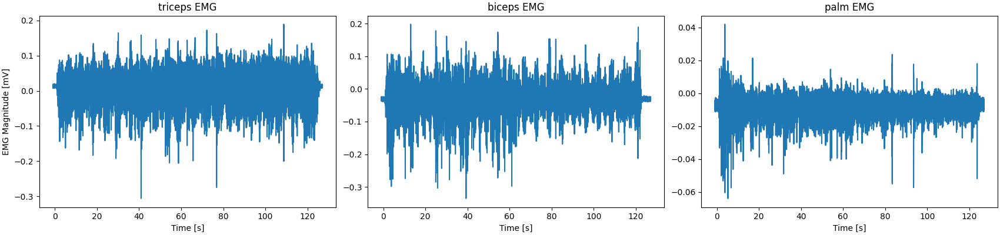

In [9]:
# Retrieve and plot EMG signals
time = h5file['timeseries/emg/time'][()]
emg_data = h5file['timeseries/emg/data'][()]

locations = h5file['timeseries/emg'].attrs['locations']
units = h5file['timeseries/emg'].attrs['units']

fig, axes = plt.subplots(1, 3, figsize=(17, 4), constrained_layout=True)
for idx, loc in enumerate(locations):
    ax = axes.flatten()[idx]
    ax.plot(time, emg_data[:, idx])
    ax.set_xlabel("Time [s]")
    if idx == 0:
        ax.set_ylabel(f"EMG Magnitude [{units}]")
    ax.set_title(f"{loc} EMG")

#### Plot and overlay tracked trajectories on the ultrasound video and play it

In [10]:
# Explore all the attributes
us_data = h5file['timeseries/us_trackers']
print("="*10 + "Ultrasound Information" + "="*10)
for k, v in us_data.attrs.items():
    print(f"{k}: {v}")

==========Ultrasound Information==========
coordinates: ['x' 'y']
depth_mm: 49.6
description: Ultrasound tracker data for arm movement. The array is a 3D array with shape (frames, trackers, coordinates).
pixel_size_mm: 0.07560483870967742
probe_placement: Left
probe_width_mm: 37.5
shape: [656 496]
sr: 59.97599304341096
tracker_names: ['br0' 'br1' 'br2' 'br3' 'tr0' 'tr1' 'tr2' 'tr3' 'fascia' 'fasciabone'
 'sidebone']
units: mm
video_name: s14004.mp4


Text(0.5, 0.98, 'Arm Ultrasound Trackers Position')

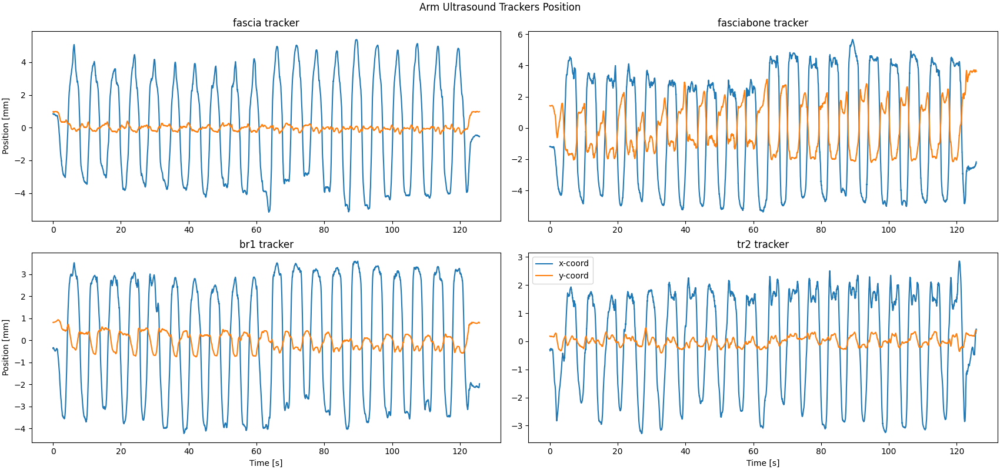

In [11]:
# Retrieve and plot 4 tracker trajectories
us_time = us_data['time'][()]
us_arrays = us_data['data'][()]

labels = np.array(['fascia', 'fasciabone', 'br1', 'tr2'])
all_labels = np.array(us_data.attrs['tracker_names'])

fig, axes = plt.subplots(2, 2, figsize=(17, 8), constrained_layout=True)
for idx, tracker in enumerate(labels):
    ax = axes.flatten()[idx]
    jdx = np.where(all_labels == tracker)[0]
    # Centering data just for visualization purposes
    data_plot = us_arrays[:, jdx] - us_arrays[:, jdx].mean(axis=0)
    ax.plot(us_time, data_plot.squeeze(axis=1), lw=1.5)
    ax.set_title(f"{tracker} tracker")
    if idx % 2 == 0:
        ax.set_ylabel("Position [mm]")
    if idx - 1 >= 1:
        ax.set_xlabel("Time [s]")
        
ax.legend(["x-coord", "y-coord", "z-coord"])
fig.suptitle("Arm Ultrasound Trackers Position")

In [12]:
# Overlay trajectories to the video and play it
# Variables to modify (frames to overlay and video path name)
start_frame = 100
end_frame = 700
save_path = os.path.join(DATASET_PATH, 'us_videos', "processed_video.mp4")

# Load video into NumPy array
video_path = os.path.join(DATASET_PATH, 'us_videos', us_data.attrs['video_name'])
cap = cv2.VideoCapture(video_path)
frames = []
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    frames.append(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Convert to RGB
cap.release()
video_array = np.stack(frames, axis=0)  # Shape (T, H, W, 3)

# Define a unique color per tracker
cmap = plt.get_cmap("Paired")
colors = [tuple(int(255 * c) for c in cmap(i)[:3]) for i in range(us_arrays.shape[1])]  # RGB for OpenCV

# Slice video and trackers. Convert trackers mm coordinates to pixel coordinates
video_chunk = video_array[start_frame:end_frame].copy()
tracker_chunk = us_arrays[start_frame:end_frame] / us_data.attrs['pixel_size_mm']

# Draw overlays
for frame, markers in zip(video_chunk, tracker_chunk):
    for i, (x, y) in enumerate(markers):
        if not np.isnan([x, y]).any():
            cv2.circle(frame, (int(x), int(y)), 8, colors[i], -1)

# Save video
height, width = video_chunk[0].shape[:2]
out = cv2.VideoWriter(save_path, cv2.VideoWriter_fourcc(*'avc1'), 30, (width, height))
for frame in video_chunk:
    out.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))  # RGB ➝ BGR
out.release()

# Play it
Video(save_path, embed=True)

In [13]:
# Remember to close the hdf5 file at the end
h5file.close()